In [1]:
# 📂 STEP 2: IMPORT LIBRARIES
import face_recognition
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt


In [2]:
# 🔍 STEP 3: LOAD TRAINING DATA
def load_data(data_folder):
    encodings = []
    names = []
    for person_name in os.listdir(data_folder):
        person_path = os.path.join(data_folder, person_name)
        if not os.path.isdir(person_path):
            continue
        for image_name in os.listdir(person_path):
            image_path = os.path.join(person_path, image_name)
            image = face_recognition.load_image_file(image_path)
            face_encs = face_recognition.face_encodings(image)
            if face_encs:
                encodings.append(face_encs[0])
                names.append(person_name)
    return encodings, names

# Example: replace with your actual paths in Colab
train_folder ="D:/Data_set/Train"
test_folder = "D:/Data_set/Test"
known_encodings, known_names = load_data(train_folder)

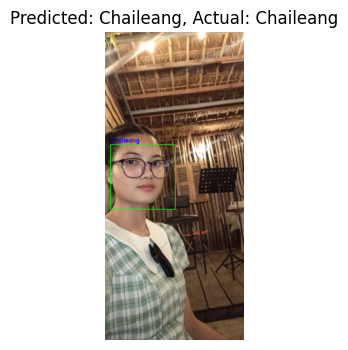

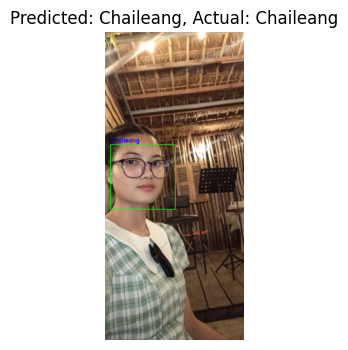

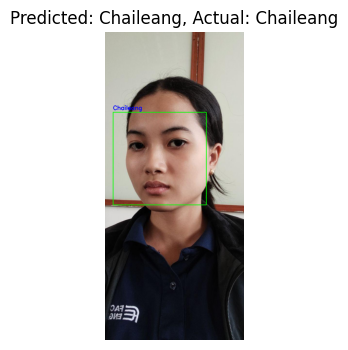

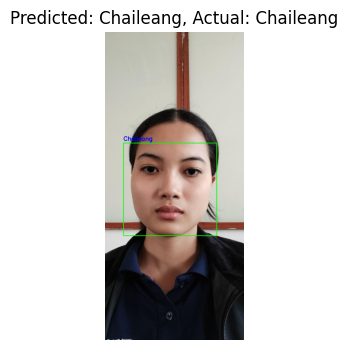

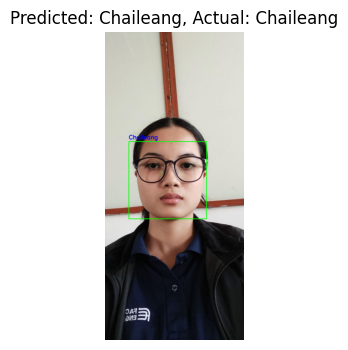

...

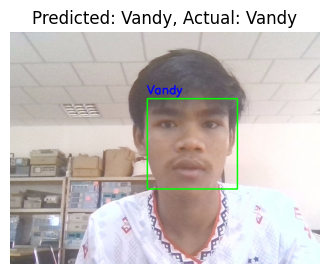

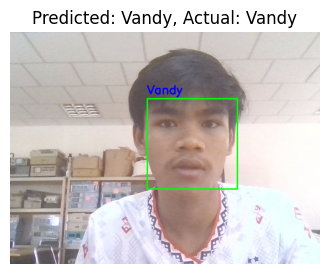

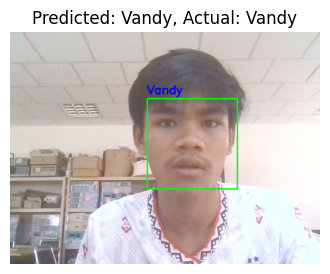

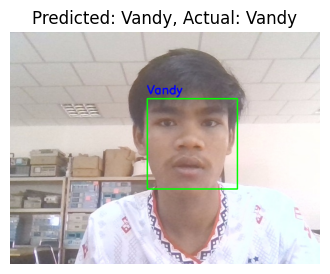

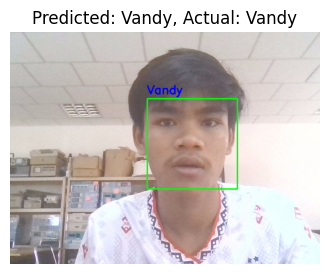


Final Accuracy: 96.67% (145/150)


In [3]:
# 👁️ STEP 4: RECOGNIZE FACES + DISPLAY IMAGES
def recognize_faces(test_folder, known_encodings, known_names):
    correct = 0
    total = 0
    for person_name in os.listdir(test_folder):
        person_folder = os.path.join(test_folder, person_name)
        if not os.path.isdir(person_folder):
            continue
        for img_name in os.listdir(person_folder):
            img_path = os.path.join(person_folder, img_name)
            image = face_recognition.load_image_file(img_path)
            face_locations = face_recognition.face_locations(image)
            face_encodings = face_recognition.face_encodings(image, face_locations)
            image_bgr = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
            for face_location, face_encoding in zip(face_locations, face_encodings):
                matches = face_recognition.compare_faces(known_encodings, face_encoding)
                face_distances = face_recognition.face_distance(known_encodings, face_encoding)
                name = "Unknown"
                if len(face_distances) > 0:
                    best_match_index = np.argmin(face_distances)
                    if matches[best_match_index]:
                        name = known_names[best_match_index]
                top, right, bottom, left = face_location
                cv2.rectangle(image_bgr, (left, top), (right, bottom), (0, 255, 0), 2)
                cv2.putText(image_bgr, name, (left, top - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 0, 0), 2)
                total += 1
                if name == person_name:
                    correct += 1
            image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
            plt.figure(figsize=(4, 4))
            plt.imshow(image_rgb)
            plt.title(f"Predicted: {name}, Actual: {person_name}")
            plt.axis("off")
            plt.show()
    accuracy = correct / total * 100 if total > 0 else 0
    print(f"\nFinal Accuracy: {accuracy:.2f}% ({correct}/{total})")

recognize_faces(test_folder, known_encodings, known_names)

In [13]:
data = (known_encodings, known_names)
with open("face_data.pkl", "wb") as f:
    pickle.dump(data, f)

print("Face data saved as face_data.pkl")

Face data saved as face_data.pkl


In [1]:
import h5py
import numpy as np

# Convert to arrays if not already
encodings_array = np.array(known_encodings)
names_array = np.array(known_names, dtype='S')  # Store strings as bytes

with h5py.File("face_data.h5", "w") as f:
    f.create_dataset("encodings", data=encodings_array)
    f.create_dataset("names", data=names_array)

print("Face data saved as face_data.h5")


NameError: name 'known_encodings' is not defined